In [ ]:
import os
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!mkdir train_local
!unzip /content/gdrive/MyDrive/NFL_Helmet/nfl-health-and-safety-helmet-assignment.zip -d train_local/

流式输出内容被截断，只能显示最后 5000 行内容。
  inflating: train_local/images/57830_000403_Sideline_frame0871.jpg  
  inflating: train_local/images/57830_000734_Endzone_frame60.jpg  
  inflating: train_local/images/57830_000734_Sideline_frame0520.jpg  
  inflating: train_local/images/57830_000734_Sideline_frame89.jpg  
  inflating: train_local/images/57830_000965_Endzone_frame192.jpg  
  inflating: train_local/images/57830_000965_Sideline_frame3.jpg  
  inflating: train_local/images/57830_001765_Sideline_frame0675.jpg  
  inflating: train_local/images/57830_002030_Endzone_frame496.jpg  
  inflating: train_local/images/57830_002030_Sideline_frame191.jpg  
  inflating: train_local/images/57830_002073_Endzone_frame1065.jpg  
  inflating: train_local/images/57830_002900_Endzone_frame166.jpg  
  inflating: train_local/images/57830_002900_Sideline_frame174.jpg  
  inflating: train_local/images/57830_002944_Endzone_frame0746.jpg  
  inflating: train_local/images/57831_000168_Endzone_frame0856.jpg  
  inflating:

In [ ]:
#reference: https://www.kaggle.com/eneszvo/yolov5-helmet-detection-train-and-inference
#https://pytorch.org/hub/ultralytics_yolov5/

In [ ]:
# Download YOLOv5
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
# Install dependencies
%pip install -qr requirements.txt  # install dependencies

%cd ../
import torch
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 9861, done.
remote: Counting objects: 100% (16/16), done.
remote: Compressing objects: 100% (13/13), done.
remote: Total 9861 (delta 7), reused 6 (delta 3), pack-reused 9845
Receiving objects: 100% (9861/9861), 10.25 MiB | 29.32 MiB/s, done.
Resolving deltas: 100% (6823/6823), done.
/content/yolov5
     |████████████████████████████████| 596 kB 5.1 MB/s 
/content
Setup complete. Using torch 1.9.0+cu111 (Tesla P100-PCIE-16GB)


In [ ]:
import os
import gc
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm
from shutil import copyfile
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from IPython.core.display import Video, display
import subprocess

In [ ]:
!ls

gdrive	sample_data  tmp  train_local  yolov5


In [ ]:
!pwd

/content


In [ ]:
TRAIN_PATH = './train_local/images/'
BATCH_SIZE = 16
EPOCHS = 2

print(f'Number of extra images: {len(os.listdir(TRAIN_PATH))}') 

Number of extra images: 9947


In [ ]:
# Load image level csv file
extra_df = pd.read_csv('./train_local/image_labels.csv')
print('Number of ground truth bounding boxes: ', len(extra_df))

# Number of unique labels
label_to_id = {label: i for i, label in enumerate(extra_df.label.unique())}
print('Unique labels: ', label_to_id)

# Group together bbox coordinates belonging to the same image. 
# key is the name of the image, value is a dataframe with label and bbox coordinates. 
image_bbox_label = {} 
for image, df in extra_df.groupby('image'): 
    image_bbox_label[image] = df.reset_index(drop=True)

# Visualize
extra_df.head()

Number of ground truth bounding boxes:  193736
Unique labels:  {'Helmet': 0, 'Helmet-Blurred': 1, 'Helmet-Difficult': 2, 'Helmet-Sideline': 3, 'Helmet-Partial': 4}


,image,label,left,width,top,height
0,57503_000116_Endzone_frame443.jpg,Helmet,1099,16,456,15
1,57503_000116_Endzone_frame443.jpg,Helmet,1117,15,478,16
2,57503_000116_Endzone_frame443.jpg,Helmet,828,16,511,15
3,57503_000116_Endzone_frame443.jpg,Helmet,746,16,519,16
4,57503_000116_Endzone_frame443.jpg,Helmet,678,17,554,17


In [ ]:
# Create train and validation split.
train_names, valid_names = train_test_split(list(image_bbox_label), test_size=0.2, random_state=42)
print(f'Size of dataset: {len(image_bbox_label)},\
       training images: {len(train_names)},\
       validation images: {len(valid_names)}')

Size of dataset: 9947,       training images: 7957,       validation images: 1990


In [ ]:
os.makedirs('tmp/nfl_extra/images/train', exist_ok=True)
os.makedirs('tmp/nfl_extra/images/valid', exist_ok=True)

os.makedirs('tmp/nfl_extra/labels/train', exist_ok=True)
os.makedirs('tmp/nfl_extra/labels/valid', exist_ok=True)

# Move the images to relevant split folder.
for img_name in tqdm(train_names):
    copyfile(f'{TRAIN_PATH}/{img_name}', f'tmp/nfl_extra/images/train/{img_name}')

for img_name in tqdm(valid_names):
    copyfile(f'{TRAIN_PATH}/{img_name}', f'tmp/nfl_extra/images/valid/{img_name}')


100%|██████████| 1990/1990 [00:06<00:00, 328.42it/s]


In [ ]:
import yaml

data_yaml = dict(
    train = './tmp/nfl_extra/images/train',
    val = './tmp/nfl_extra/images/valid',
    nc = 5,
    names = list(extra_df.label.unique())
)

# Note that the file is created in the yolov5/data/ directory.
with open('yolov5/data/data.yaml', 'w') as outfile:
    yaml.dump(data_yaml, outfile, default_flow_style=True)

In [ ]:
def get_yolo_format_bbox(img_w, img_h, box):
    """
    Convert the bounding boxes in YOLO format.
    
    Input:
    img_w - Original/Scaled image width
    img_h - Original/Scaled image height
    box - Bounding box coordinates in the format, "left, width, top, height"
    
    Output:
    Return YOLO formatted bounding box coordinates, "x_center y_center width height".
    """
    w = box.width # width 
    h = box.height # height
    xc = box.left + int(np.round(w/2)) # xmin + width/2
    yc = box.top + int(np.round(h/2)) # ymin + height/2

    return [xc/img_w, yc/img_h, w/img_w, h/img_h] # x_center y_center width height
    
# Iterate over each image and write the labels and bbox coordinates to a .txt file. 
for img_name, df in tqdm(image_bbox_label.items()):
    # open image file to get the height and width 
    img = cv2.imread(TRAIN_PATH+'/'+img_name)
    height, width, _ = img.shape 
    
    # iterate over bounding box df
    bboxes = []
    for i in range(len(df)):
        # get a row
        box = df.loc[i]
        # get bbox in YOLO format
        box = get_yolo_format_bbox(width, height, box)
        bboxes.append(box)
    
    if img_name in train_names:
        img_name = img_name[:-4]
        file_name = f'tmp/nfl_extra/labels/train/{img_name}.txt'
    elif img_name in valid_names:
        img_name = img_name[:-4]
        file_name = f'tmp/nfl_extra/labels/valid/{img_name}.txt'
        
    with open(file_name, 'w') as f:
        for i, bbox in enumerate(bboxes):
            label = label_to_id[df.loc[i].label]
            bbox = [label]+bbox
            bbox = [str(i) for i in bbox]
            bbox = ' '.join(bbox)
            f.write(bbox)
            f.write('\n')

100%|██████████| 9947/9947 [03:59<00:00, 41.57it/s]


In [ ]:
BATCH_SIZE = 6
EPOCHS = 30

In [ ]:
!python yolov5/train.py --img 1280 \
                 --batch {BATCH_SIZE} \
                 --epochs {EPOCHS} \
                 --data yolov5/data/data.yaml \
                 --weights yolov5/yolov5l6.pt \
                 --label-smoothing 0.1\
                 --save-period 1 \
                 --linear-lr\
                 --resume /content/nfl-extra/exp10/weights/best.pt\
                 --project nfl-extra

train: weights=yolov5/yolov5l6.pt, cfg=, data=yolov5/data/data.yaml, hyp=yolov5/data/hyps/hyp.scratch.yaml, epochs=18, batch_size=6, imgsz=1280, rect=False, resume=/content/nfl-extra/exp10/weights/best.pt, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=nfl-extra, name=exp, exist_ok=False, quad=False, linear_lr=True, label_smoothing=0.1, patience=100, freeze=0, save_period=1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: skipping check (not a git repository), for updates see https://github.com/ultralytics/yolov5
Resuming training from /content/nfl-extra/exp10/weights/best.pt
YOLOv5 🚀 v6.0-40-g8c326a1 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1,

In [ ]:
!ls

58102_002798_Endzone  gdrive  nfl-extra  sample_data  tmp  train_local	yolov5


In [ ]:
!python yolov5/val.py --img 1280 \
                 --batch {BATCH_SIZE} \
                 --data yolov5/data/data.yaml \
                 --weights /content/nfl-extra/exp10/weights/yolov5l6-best.pt \
                 --project nfl-extra

val: data=yolov5/data/data.yaml, weights=['/content/nfl-extra/exp10/weights/yolov5l6-best.pt'], batch_size=6, imgsz=1280, conf_thres=0.001, iou_thres=0.6, task=val, device=, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=nfl-extra, name=exp, exist_ok=False, half=False
YOLOv5 🚀 v6.0-40-g8c326a1 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
Model Summary: 476 layers, 76149432 parameters, 0 gradients, 110.1 GFLOPs
val: Scanning 'tmp/nfl_extra/labels/valid.cache' images and labels... 1990 found, 0 missing, 0 empty, 0 corrupted: 100% 1990/1990 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 332/332 [01:44<00:00,  3.16it/s]
                 all       1990      38708      0.635      0.503      0.462      0.254
              Helmet       1990      25709      0.772      0.944      0.927      0.619
      Helmet-Blurred      

#visaulize

In [ ]:
exp_path='/content/nfl-extra/exp11'

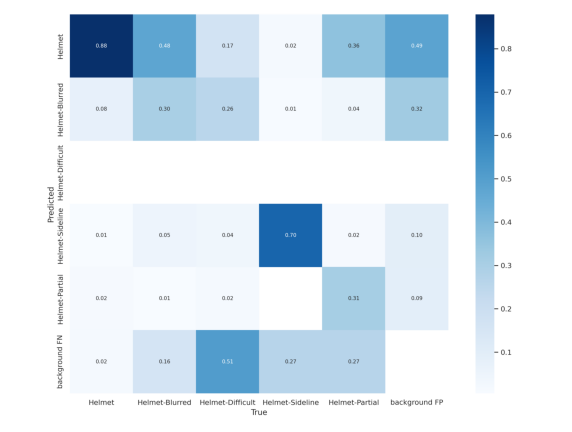

In [ ]:
plt.figure(figsize=(10,10))
plt.axis('off')
plt.imshow(plt.imread(f'{exp_path}/confusion_matrix.png'));

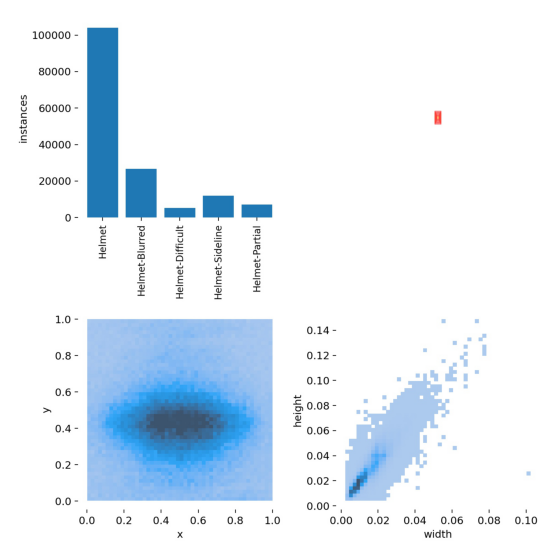

In [ ]:
plt.figure(figsize = (20,10))
plt.axis('off')
plt.imshow(plt.imread(f'{exp_path}/labels.jpg'));

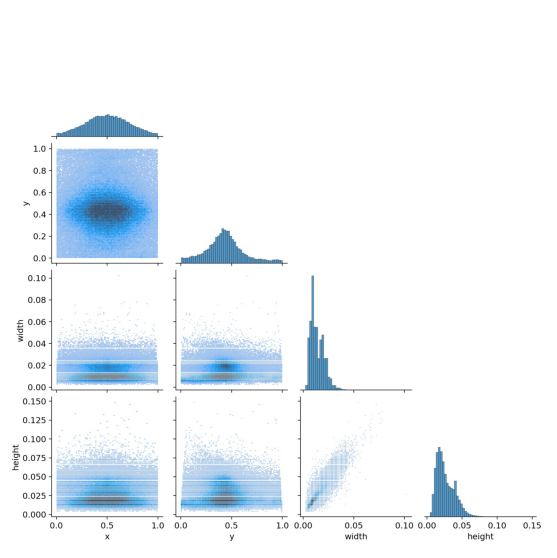

In [ ]:
plt.figure(figsize = (20,10))
plt.axis('off')
plt.imshow(plt.imread(f'{exp_path}/labels_correlogram.jpg'));

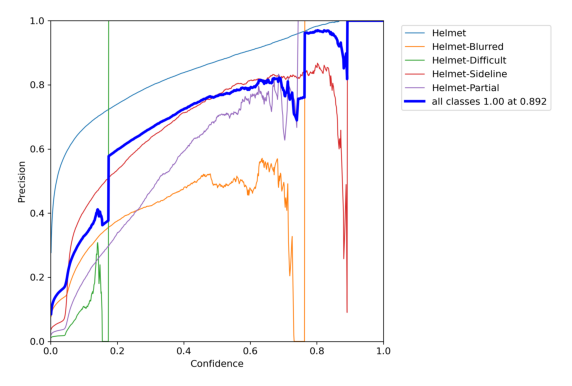

In [ ]:
#!ls /kaggle/working/yolov5/kaggle-NFL/exp
plt.figure(figsize=(10,10))
plt.axis('off')
plt.imshow(plt.imread(f'{exp_path}/P_curve.png'));

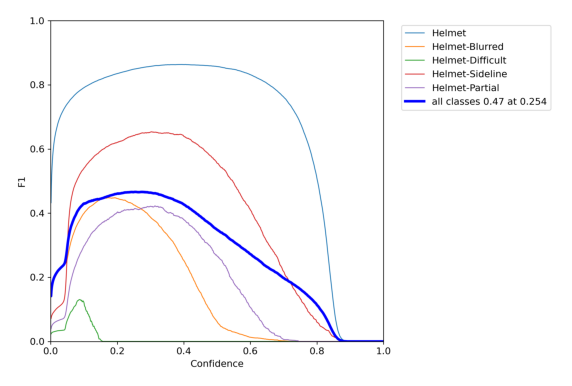

In [ ]:
#!ls /kaggle/working/yolov5/kaggle-NFL/exp
plt.figure(figsize=(10,10))
plt.axis('off')
plt.imshow(plt.imread(f'{exp_path}/F1_curve.png'));

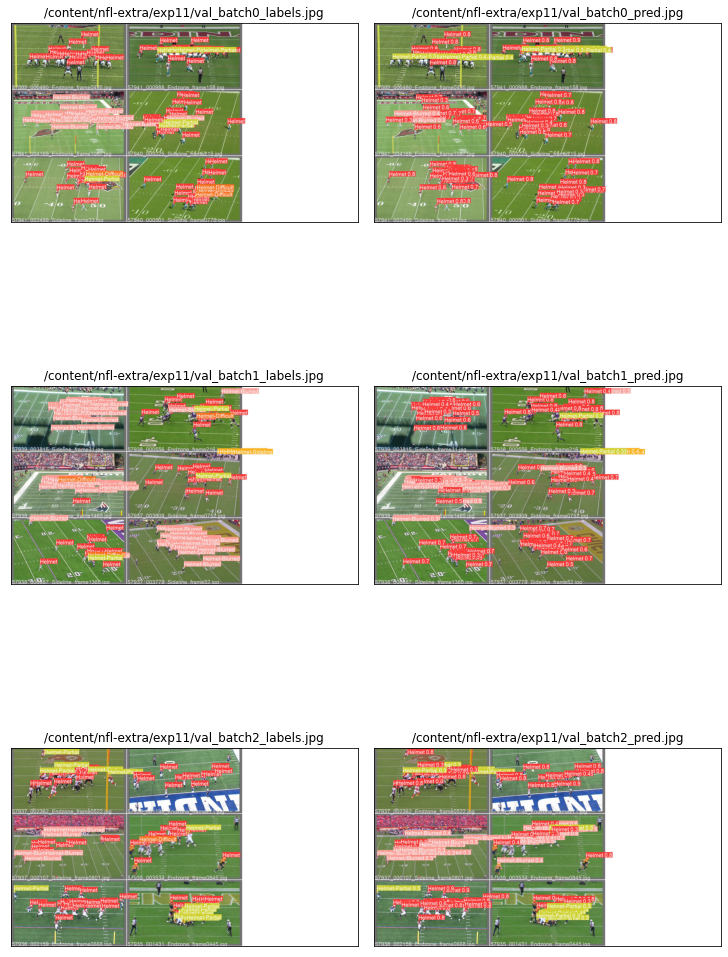

In [ ]:
ig, ax = plt.subplots(3, 2, figsize = (2*5,3*5), constrained_layout = True)
for row in range(3):
    ax[row][0].imshow(plt.imread(f'{exp_path}/val_batch{row}_labels.jpg'))
    ax[row][0].set_xticks([])
    ax[row][0].set_yticks([])
    ax[row][0].set_title(f'{exp_path}/val_batch{row}_labels.jpg', fontsize = 12)
    
    ax[row][1].imshow(plt.imread(f'{exp_path}/val_batch{row}_pred.jpg'))
    ax[row][1].set_xticks([])
    ax[row][1].set_yticks([])
    ax[row][1].set_title(f'{exp_path}/val_batch{row}_pred.jpg', fontsize = 12)

# detect

In [ ]:
ex_video = 'train_local/test/58102_002798_Endzone.mp4'

frac = 0.6
display(Video(ex_video, embed=True))

In [ ]:
img_ext = 'png'
image_name = '58102_002798_Endzone'
frame_dir = 'train_local/mp4_img/'

os.makedirs(frame_dir, exist_ok=True)
cmd = 'ffmpeg -i \"{}\" -qscale:v 2 \"{}/{}_%d.{}\"'.format(ex_video, frame_dir, image_name, img_ext)
print(cmd)
subprocess.call(cmd, shell=True)

ffmpeg -i "train_local/test/58102_002798_Endzone.mp4" -qscale:v 2 "train_local/mp4_img//58102_002798_Endzone_%d.png"


0

In [ ]:
best_w = '/content/gdrive/MyDrive/NFL_Helmet/yolov5l6-best.pt' #New
#best_w='/kaggle/input/nfl-weights/yolov5/kaggle-NFL/exp/weights/best.pt' # last
IMG_S=1280

project_name = '58102_002798_Endzone'

!python yolov5/detect.py --weights {best_w} \
                  --source {frame_dir} \
                  --img {IMG_S} \
                  --save-txt \
                  --save-conf \
                  --project {project_name}

detect: weights=['/content/gdrive/MyDrive/NFL_Helmet/yolov5l6-best.pt'], source=train_local/mp4_img/, imgsz=[1280, 1280], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=58102_002798_Endzone, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-40-g8c326a1 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
Model Summary: 476 layers, 76149432 parameters, 0 gradients, 110.1 GFLOPs
image 1/366 /content/train_local/mp4_img/58102_002798_Endzone_1.png: 768x1280 16 Helmets, Done. (0.049s)
image 2/366 /content/train_local/mp4_img/58102_002798_Endzone_10.png: 768x1280 16 Helmets, Done. (0.045s)
image 3/366 /content/train_local/mp4_img/58102_002798_Endzone_100.png: 768x1280 15 Helmets, 1 Helmet-Partial, Done. (0.045s)
image 4/366 /con

In [ ]:
video_name = '58102_002798_Endzone_fps50.mp4'

tmp_video_path = os.path.join('', f'tmp_{video_name}')
video_path = os.path.join('', video_name)

frame_rate = 60

images = [img for img in os.listdir(f'{project_name}/exp4')]
images.remove('labels')
images.sort(key = lambda x: int(x.split('_')[-1][:-4]))

frame = cv2.imread(os.path.join('58102_002798_Endzone/exp4', images[0]))
height, width, layers = frame.shape

video = cv2.VideoWriter(tmp_video_path, cv2.VideoWriter_fourcc(*'MP4V'),
                        frame_rate, (width,height))

for f in images:
    img = cv2.imread(os.path.join('58102_002798_Endzone/exp4', f))
    video.write(img)

video.release()

# Not all browsers support the codec, we will re-load the file at tmp_video_path
# and convert to a codec that is more broadly readable using ffmpeg

if os.path.exists(video_path):
    os.remove(video_path)
    
subprocess.run(["ffmpeg", "-i", tmp_video_path, "-crf", "18", "-preset", "veryfast",
                "-vcodec","libx264", video_path,])

os.remove(tmp_video_path)

In [ ]:
frac = 0.60
print(video_path)
display(Video(video_path, embed=True))

58102_002798_Endzone_fps50.mp4


#save to gdrive

In [ ]:
!cp -r /content/nfl-extra/exp9/ /content/gdrive/MyDrive/NFL_Helmet/model/yolov5m-30

#what to do next?

In [ ]:
# 1. try different model
# 2. train hypterparemeter [https://github.com/ultralytics/yolov5/issues/607]
# 3. try model ensemble
# 4. use wandb to visualize?
# 5. try single class
# 6. try pre-trained weight from others